<a href="https://colab.research.google.com/github/aparnashenoy/ml/blob/master/smote_final.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip 

     / 56.5MB 74.2MB/s
     |████████████████████████████████| 81kB 3.8MB/s 
     |████████████████████████████████| 604kB 11.3MB/s 
     |████████████████████████████████| 3.1MB 16.2MB/s 
     |████████████████████████████████| 71kB 8.0MB/s 
     |████████████████████████████████| 296kB 34.5MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-2.10.0-py2.py3-none-any.whl size=232422 sha256=963ad155ae94a4b7a7575d8e8a42c126c96eeb76bc6daa9281e242dcc1509a68
  Stored in directory: /tmp/pip-ephem-wheel-cache-embv_kki/wheels/56/c2/dd/8d945b0443c35df7d5f62fa9e9ae105a2d8b286302b92e0109
  Created wheel for htmlmin: filename=htmlmin-0.1.12-cp36-none-any.whl size=27085 sha256=18e9ab99dbc71ac23bc7b87a5e93651131662c31e1c684e03947901958185a2f
  Stored in directory: /root/.cache/pip/wheels/43/07/ac/7c5a9d708d65247ac1f94066cf1db075540b85716c30255459
Successfully built pandas-profiling htmlmin
  Found existing installation: tqdm 4.41.1
    Uninstalling tqdm-4.41.1:
      Successfully un

In [1]:
from pandas_profiling import ProfileReport

In [2]:
from google.colab import drive
drive.mount('/gdrive')

Mounted at /gdrive


In [3]:
path = '/gdrive/My Drive/'

In [30]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

In [5]:
from matplotlib import rcParams
rcParams['figure.figsize'] = 20, 14

In [6]:
from matplotlib.cm import rainbow

In [7]:
df = pd.read_csv(path + 'data_cvs_resp.csv')

In [8]:
df.drop(['Unnamed: 0'], axis = 1, inplace= True)

In [9]:
cols=df.shape[1]
print("columns = {}".format(cols))

columns = 9


In [10]:
df.head()

,HR,O2Sat,SBP,MAP,DBP,Resp,Age,Gender,SepsisLabel
0,99.0,100.0,120.0,71.0,61.0,13.5,69.66,0,0
1,97.5,100.0,120.0,79.0,61.0,15.0,69.66,0,0
2,96.0,100.0,120.0,70.0,61.0,13.0,69.66,0,0
3,100.0,99.0,120.0,75.0,61.0,14.0,69.66,0,0
4,102.0,100.0,120.0,74.0,61.0,17.0,69.66,0,0


In [11]:
df.columns = map(str.lower, df.columns)
df.columns

Index(['hr', 'o2sat', 'sbp', 'map', 'dbp', 'resp', 'age', 'gender',
       'sepsislabel'],
      dtype='object')

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1167202 entries, 0 to 1167201
Data columns (total 9 columns):
 #   Column       Non-Null Count    Dtype  
---  ------       --------------    -----  
 0   hr           1167202 non-null  float64
 1   o2sat        1167202 non-null  float64
 2   sbp          1167202 non-null  float64
 3   map          1167202 non-null  float64
 4   dbp          1167202 non-null  float64
 5   resp         1167202 non-null  float64
 6   age          1167202 non-null  float64
 7   gender       1167202 non-null  int64  
 8   sepsislabel  1167202 non-null  int64  
dtypes: float64(7), int64(2)
memory usage: 80.1 MB


In [13]:
df['sepsislabel'] = df['sepsislabel'].astype('category')

In [14]:
df['gender']=df['gender'].astype('category')

In [15]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1167202 entries, 0 to 1167201
Data columns (total 9 columns):
 #   Column       Non-Null Count    Dtype   
---  ------       --------------    -----   
 0   hr           1167202 non-null  float64 
 1   o2sat        1167202 non-null  float64 
 2   sbp          1167202 non-null  float64 
 3   map          1167202 non-null  float64 
 4   dbp          1167202 non-null  float64 
 5   resp         1167202 non-null  float64 
 6   age          1167202 non-null  float64 
 7   gender       1167202 non-null  category
 8   sepsislabel  1167202 non-null  category
dtypes: category(2), float64(7)
memory usage: 64.6 MB


In [16]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
hr,1167202.0,84.213367,13.138542,64.0,74.0,84.00,94.00,106.0
o2sat,1167202.0,97.529540,1.965434,94.0,96.0,98.00,99.00,100.0
sbp,1167202.0,121.730389,16.610081,97.5,109.0,120.00,134.00,151.0
map,1167202.0,79.948555,10.731372,64.0,71.0,79.00,88.50,97.0
dbp,1167202.0,61.454623,6.991990,50.0,58.0,61.00,64.50,74.0
resp,1167202.0,18.451131,3.638062,13.0,16.0,18.00,21.00,25.0
age,1167202.0,62.333790,16.280111,14.0,52.0,64.08,74.96,100.0


In [17]:
df=df.sample(n=20000, random_state=1234, axis=None, weights=None)

In [18]:
df.sepsislabel.value_counts()

0    19612
1      388
Name: sepsislabel, dtype: int64

In [19]:
profile = ProfileReport(df)

In [20]:
profile

In [21]:
profile.to_notebook_iframe()

In [22]:
profile.to_file(output_file = path+ 'cvs_rr.html')

In [23]:
corr = df.corr()
corr

,hr,o2sat,sbp,map,dbp,resp,age
hr,1.000000,-0.073689,-0.030338,0.080877,0.115642,0.213861,-0.148077
o2sat,-0.073689,1.000000,0.010533,0.015726,0.001491,-0.158406,-0.041075
sbp,-0.030338,0.010533,1.000000,0.758075,0.456250,0.044261,0.020765
map,0.080877,0.015726,0.758075,1.000000,0.718562,0.038539,-0.141518
dbp,0.115642,0.001491,0.456250,0.718562,1.000000,0.030669,-0.220088
resp,0.213861,-0.158406,0.044261,0.038539,0.030669,1.000000,0.050173
age,-0.148077,-0.041075,0.020765,-0.141518,-0.220088,0.050173,1.000000


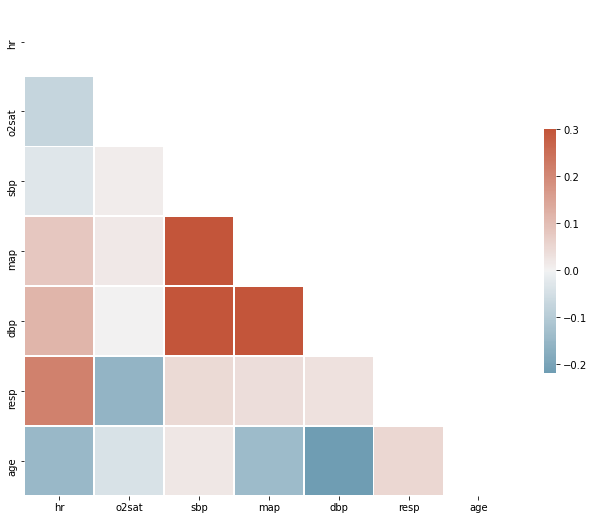

In [31]:
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(11, 9))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

In [32]:
y = df.sepsislabel.values
x = df.drop(["sepsislabel", 'gender'], axis = 1)

In [33]:
x=(x-x.mean())/(x.max()-x.min())

In [34]:
x.head()

,hr,o2sat,sbp,map,dbp,resp,age
350586,0.185139,0.079287,-0.258963,-0.061076,-0.021065,-0.040390,-0.324787
300080,-0.029147,-0.420713,0.544775,0.514681,0.520602,-0.123723,0.102475
1136672,0.518472,0.079287,0.096177,0.484378,0.520602,-0.040390,-0.159906
31178,-0.243433,0.412621,-0.455225,-0.313500,-0.021065,-0.332056,-0.062644
1135430,-0.052957,0.079287,0.395242,0.151045,-0.479398,-0.457056,-0.207525


In [35]:
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.30, random_state=42)

In [36]:
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((14000, 7), (6000, 7), (14000,), (6000,))

In [37]:
from sklearn.linear_model import LogisticRegression
model = LogisticRegression(max_iter=10000)

model.fit(x_train, y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=10000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=None, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)

In [38]:
train_pred = model.predict(x_train)

test_pred = model.predict(x_test)

# Use score method to get accuracy of model
score = model.score(x_train, y_train)
print('Train F1 Score = {} %'.format(round(score,4)*100))

# Use score method to get accuracy of model
score = model.score(x_test, y_test)
print('Test F1 Score = {} %'.format(round(score,4)*100))

Train F1 Score = 98.1 %
Test F1 Score = 97.97 %


In [39]:
from sklearn.metrics import accuracy_score

train_accuracy = accuracy_score(y_train, train_pred)
train_accuracy = round(train_accuracy, 4)*100
print('Training Accuracy = {} %'.format(train_accuracy))

test_accuracy = accuracy_score(y_test, test_pred)
test_accuracy = round(test_accuracy, 4)*100
print('Test Accuracy = {} %'.format(test_accuracy))

Training Accuracy = 98.1 %
Test Accuracy = 97.97 %


[[5878    0]
 [ 122    0]]


Text(0.5, 1.0, 'Test F1 Score:97.97%')

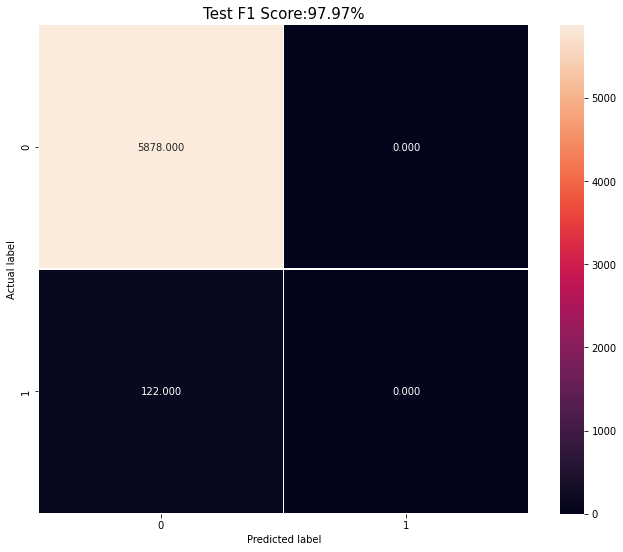

In [40]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

conf_matrix = confusion_matrix(y_test, test_pred)
print(conf_matrix)

plt.figure(figsize=(11,9))
sns.heatmap(conf_matrix, annot=True, fmt=".3f", linewidths=.5)

plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Test F1 Score:{}%'.format(round(score, 4)*100)
plt.title(all_sample_title, size = 15)

In [41]:
from sklearn.metrics import classification_report

print('*********************  Training Data Report  **********')
print(classification_report(y_train, train_pred))

print('***********************  Test Data Report  **********')
print(classification_report(y_test, test_pred))


*********************  Training Data Report  **********
              precision    recall  f1-score   support

           0       0.98      1.00      0.99     13734
           1       0.00      0.00      0.00       266

    accuracy                           0.98     14000
   macro avg       0.49      0.50      0.50     14000
weighted avg       0.96      0.98      0.97     14000

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.98      1.00      0.99      5878
           1       0.00      0.00      0.00       122

    accuracy                           0.98      6000
   macro avg       0.49      0.50      0.49      6000
weighted avg       0.96      0.98      0.97      6000



/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [42]:
print(test_pred)

[0 0 0 ... 0 0 0]


##smote technique

In [43]:
import imblearn

/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


In [44]:
from imblearn.over_sampling import SMOTE
smt = SMOTE()
x_train, y_train = smt.fit_sample(x_train, y_train)
np.bincount(y_train)

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


array([13734, 13734])

In [45]:
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression()
logreg.fit(x_train, y_train)
y_pred = logreg.predict(x_test)
print('Accuracy of logistic regression classifier on test set: {:.2f}'.format(logreg.score(x_test, y_test)))

Accuracy of logistic regression classifier on test set: 0.63


In [46]:
train_pred = logreg.predict(x_train)

test_pred = logreg.predict(x_test)

# Use score method to get accuracy of model
score = logreg.score(x_train, y_train)
print('Train F1 Score = {} %'.format(round(score,4)*100))

# Use score method to get accuracy of model
score = logreg.score(x_test, y_test)
print('Test F1 Score = {} %'.format(round(score,4)*100))

Train F1 Score = 60.72 %
Test F1 Score = 62.519999999999996 %


[[3701 2177]
 [  72   50]]


Text(0.5, 1.0, 'Test F1 Score:62.519999999999996%')

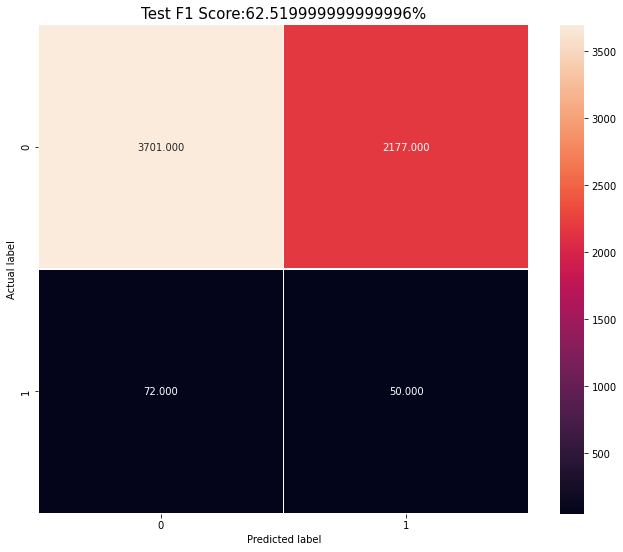

In [47]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

conf_matrix = confusion_matrix(y_test, test_pred)
print(conf_matrix)

plt.figure(figsize=(11,9))
sns.heatmap(conf_matrix, annot=True, fmt=".3f", linewidths=.5)

plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Test F1 Score:{}%'.format(round(score, 4)*100)
plt.title(all_sample_title, size = 15)

In [48]:
from sklearn.metrics import classification_report

print('*********************  Training Data Report  **********')
print(classification_report(y_train, train_pred))

print('***********************  Test Data Report  **********')
print(classification_report(y_test, test_pred))

*********************  Training Data Report  **********
              precision    recall  f1-score   support

           0       0.60      0.63      0.62     13734
           1       0.61      0.59      0.60     13734

    accuracy                           0.61     27468
   macro avg       0.61      0.61      0.61     27468
weighted avg       0.61      0.61      0.61     27468

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.98      0.63      0.77      5878
           1       0.02      0.41      0.04       122

    accuracy                           0.63      6000
   macro avg       0.50      0.52      0.40      6000
weighted avg       0.96      0.63      0.75      6000



In [49]:
from sklearn.svm import SVC
classifier_rbf = SVC(kernel = 'rbf')
classifier_rbf.fit(x_train, y_train)
y_pred = classifier_rbf.predict(x_test)
print('Accuracy of SVC (RBF) classifier on test set: {:.2f}'.format(classifier_rbf.score(x_test, y_test)))

Accuracy of SVC (RBF) classifier on test set: 0.74


In [50]:
train_pred = classifier_rbf.predict(x_train)

test_pred = classifier_rbf.predict(x_test)

# Use score method to get accuracy of model
score = classifier_rbf.score(x_train, y_train)
print('Train F1 Score = {} %'.format(round(score,4)*100))

# Use score method to get accuracy of model
score = classifier_rbf.score(x_test, y_test)
print('Test F1 Score = {} %'.format(round(score,4)*100))

Train F1 Score = 79.43 %
Test F1 Score = 73.77 %


[[4392 1486]
 [  88   34]]


Text(0.5, 1.0, 'Test F1 Score:73.77%')

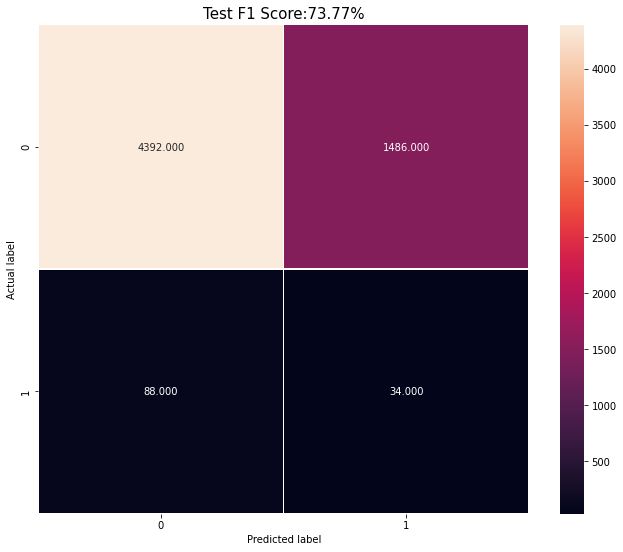

In [51]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

conf_matrix = confusion_matrix(y_test, test_pred)
print(conf_matrix)

plt.figure(figsize=(11,9))
sns.heatmap(conf_matrix, annot=True, fmt=".3f", linewidths=.5)

plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Test F1 Score:{}%'.format(round(score, 4)*100)
plt.title(all_sample_title, size = 15)

In [52]:
from sklearn.metrics import classification_report

print('*********************  Training Data Report  **********')
print(classification_report(y_train, train_pred))

print('***********************  Test Data Report  **********')
print(classification_report(y_test, test_pred))

*********************  Training Data Report  **********
              precision    recall  f1-score   support

           0       0.82      0.75      0.78     13734
           1       0.77      0.84      0.80     13734

    accuracy                           0.79     27468
   macro avg       0.80      0.79      0.79     27468
weighted avg       0.80      0.79      0.79     27468

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.98      0.75      0.85      5878
           1       0.02      0.28      0.04       122

    accuracy                           0.74      6000
   macro avg       0.50      0.51      0.44      6000
weighted avg       0.96      0.74      0.83      6000



In [53]:
svc_scores = []
kernels = ['linear', 'poly', 'rbf', 'sigmoid']
for i in range(len(kernels)):
    svc_classifier = SVC(kernel = kernels[i])
    svc_classifier.fit(x_train, y_train)
    svc_scores.append(svc_classifier.score(x_test, y_test))

Text(0.5, 1.0, 'Support Vector Classifier scores for different kernels')

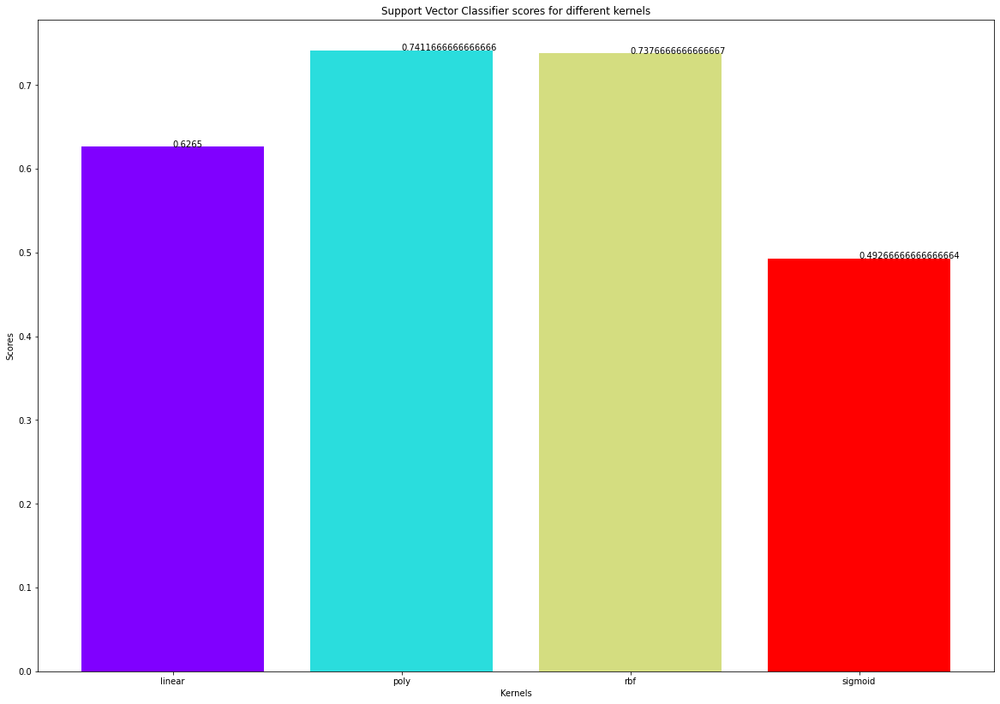

In [64]:
rcParams['figure.figsize'] = 20, 14
colors = rainbow(np.linspace(0, 1, len(kernels)))
plt.bar(kernels, svc_scores, color = colors)
for i in range(len(kernels)):
    plt.text(i, svc_scores[i], svc_scores[i])
plt.xlabel('Kernels')
plt.ylabel('Scores')
plt.title('Support Vector Classifier scores for different kernels')

In [55]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=300, bootstrap = True, max_features = 'sqrt')
rfc.fit(x_train, y_train)
y_pred = rfc.predict(x_test)
print('Accuracy of Random Forest on test set: {:.2f}'.format(rfc.score(x_test, y_test)))

Accuracy of Random Forest on test set: 0.96


In [56]:
train_pred = rfc.predict(x_train)

test_pred = rfc.predict(x_test)

# Use score method to get accuracy of model
score = rfc.score(x_train, y_train)
print('Train F1 Score = {} %'.format(round(score,4)*100))

# Use score method to get accuracy of model
score = rfc.score(x_test, y_test)
print('Test F1 Score = {} %'.format(round(score,4)*100))

Train F1 Score = 99.97 %
Test F1 Score = 95.58 %


[[5732  146]
 [ 119    3]]


Text(0.5, 1.0, 'Test F1 Score:95.58%')

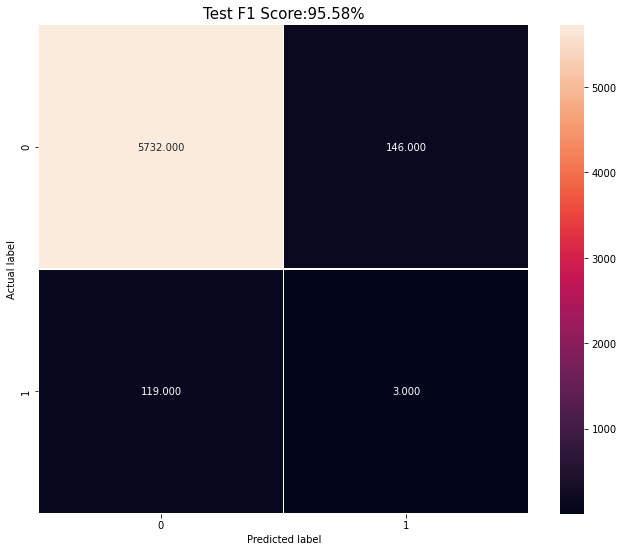

In [57]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

conf_matrix = confusion_matrix(y_test, test_pred)
print(conf_matrix)

plt.figure(figsize=(11,9))
sns.heatmap(conf_matrix, annot=True, fmt=".3f", linewidths=.5)

plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Test F1 Score:{}%'.format(round(score, 4)*100)
plt.title(all_sample_title, size = 15)

In [58]:
from sklearn.metrics import classification_report

print('*********************  Training Data Report  **********')
print(classification_report(y_train, train_pred))

print('***********************  Test Data Report  **********')
print(classification_report(y_test, test_pred))

*********************  Training Data Report  **********
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     13734
           1       1.00      1.00      1.00     13734

    accuracy                           1.00     27468
   macro avg       1.00      1.00      1.00     27468
weighted avg       1.00      1.00      1.00     27468

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.98      0.98      0.98      5878
           1       0.02      0.02      0.02       122

    accuracy                           0.96      6000
   macro avg       0.50      0.50      0.50      6000
weighted avg       0.96      0.96      0.96      6000



In [59]:
rf_scores = []
estimators = [10, 100, 200, 500, 1000]
for i in estimators:
    rf_classifier = RandomForestClassifier(n_estimators = i, random_state = 0)
    rf_classifier.fit(x_train, y_train)
    rf_scores.append(rf_classifier.score(x_test, y_test))

Text(0.5, 1.0, 'Random Forest Classifier scores for different number of estimators')

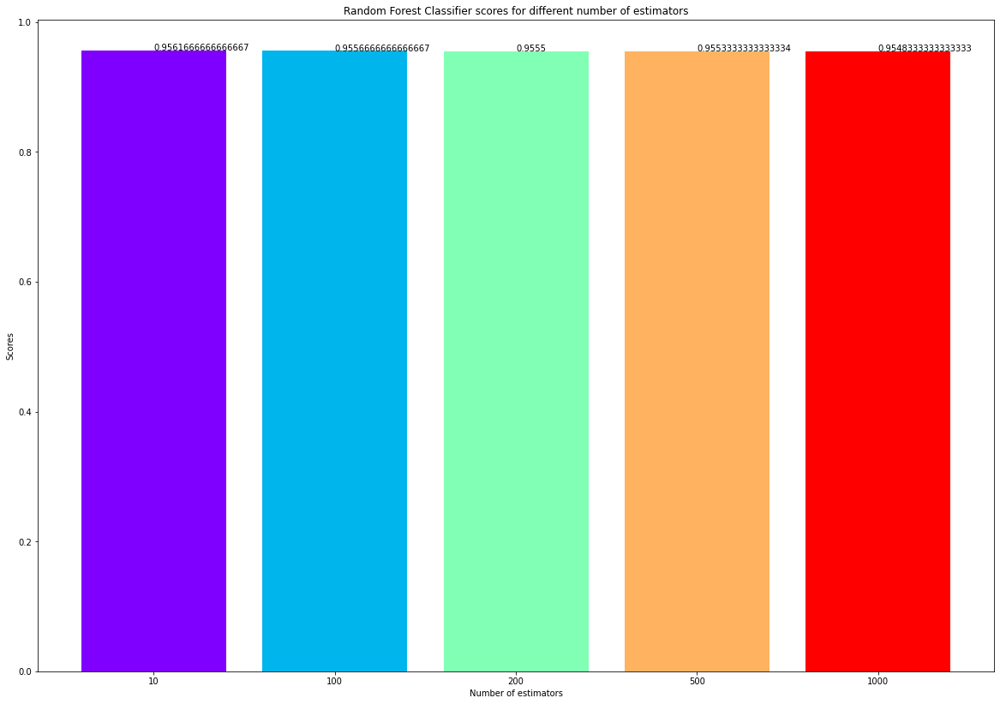

In [65]:
rcParams['figure.figsize'] = 20, 14
colors = rainbow(np.linspace(0, 1, len(estimators)))
plt.bar([i for i in range(len(estimators))], rf_scores, color = colors, width = 0.8)
for i in range(len(estimators)):
    plt.text(i, rf_scores[i], rf_scores[i])
plt.xticks(ticks = [i for i in range(len(estimators))], labels = [str(estimator) for estimator in estimators])
plt.xlabel('Number of estimators')
plt.ylabel('Scores')
plt.title('Random Forest Classifier scores for different number of estimators')

In [61]:
from sklearn.tree import DecisionTreeClassifier

In [62]:
dt_scores = []
for i in range(1, len(x.columns) + 1):
    dt_classifier = DecisionTreeClassifier(max_features = i, random_state = 0)
    dt_classifier.fit(x_train, y_train)
    dt_scores.append(dt_classifier.score(x_test, y_test))

Text(0.5, 1.0, 'Decision Tree Classifier scores for different number of maximum features')

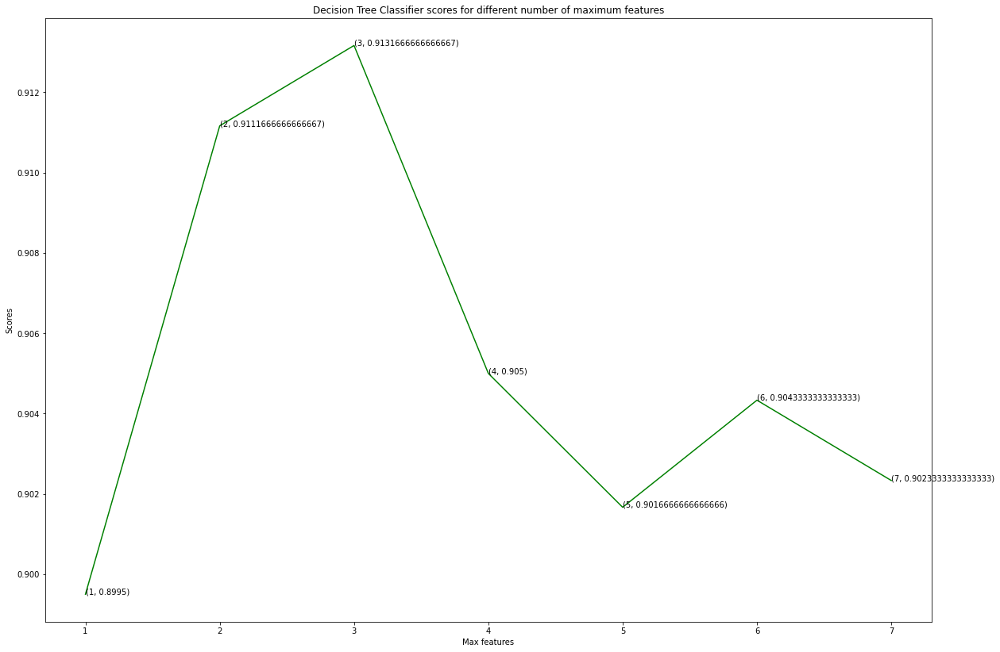

In [66]:
rcParams['figure.figsize'] = 20, 14
plt.plot([i for i in range(1, len(x.columns) + 1)], dt_scores, color = 'green')
for i in range(1, len(x.columns) + 1):
    plt.text(i, dt_scores[i-1], (i, dt_scores[i-1]))
plt.xticks([i for i in range(1, len(x.columns) + 1)])
plt.xlabel('Max features')
plt.ylabel('Scores')
plt.title('Decision Tree Classifier scores for different number of maximum features')

In [67]:
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO 
from IPython.display import Image 
from pydot import graph_from_dot_data

In [69]:
feature_columns = x.columns

In [70]:
feature_columns

Index(['hr', 'o2sat', 'sbp', 'map', 'dbp', 'resp', 'age'], dtype='object')

In [73]:
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
rcParams['figure.figsize'] = 20, 14
dot_data = StringIO()
export_graphviz(dt_classifier, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True, feature_names = feature_columns,class_names=['0','1'])
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
graph.write_png(path+'sepsis.png')
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.393432 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.393432 to fit



In [74]:
from sklearn import tree

In [75]:
text_representation = tree.export_text(dt_classifier)
print(text_representation)

|--- feature_5 <= -0.46
|   |--- feature_4 <= -0.36
|   |   |--- feature_1 <= 0.08
|   |   |   |--- feature_0 <= 0.05
|   |   |   |   |--- class: 0
|   |   |   |--- feature_0 >  0.05
|   |   |   |   |--- feature_6 <= 0.15
|   |   |   |   |   |--- class: 0
|   |   |   |   |--- feature_6 >  0.15
|   |   |   |   |   |--- feature_6 <= 0.15
|   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |--- feature_6 >  0.15
|   |   |   |   |   |   |--- feature_4 <= -0.45
|   |   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |   |--- feature_4 >  -0.45
|   |   |   |   |   |   |   |--- feature_1 <= -0.25
|   |   |   |   |   |   |   |   |--- class: 1
|   |   |   |   |   |   |   |--- feature_1 >  -0.25
|   |   |   |   |   |   |   |   |--- class: 0
|   |   |--- feature_1 >  0.08
|   |   |   |--- feature_1 <= 0.41
|   |   |   |   |--- feature_2 <= -0.23
|   |   |   |   |   |--- feature_0 <= -0.39
|   |   |   |   |   |   |--- class: 0
|   |   |   |   |   |--- feature_0 >  -0.39
|   |   |   |  

In [79]:
train_pred = dt_classifier.predict(x_train)

test_pred = dt_classifier.predict(x_test)

# Use score method to get accuracy of model
score = dt_classifier.score(x_train, y_train)
print('Train F1 Score = {} %'.format(round(score,4)*100))

# Use score method to get accuracy of model
score = dt_classifier.score(x_test, y_test)
print('Test F1 Score = {} %'.format(round(score,4)*100))

Train F1 Score = 99.97 %
Test F1 Score = 90.23 %


[[5404  474]
 [ 112   10]]


Text(0.5, 1.0, 'Test F1 Score:90.23%')

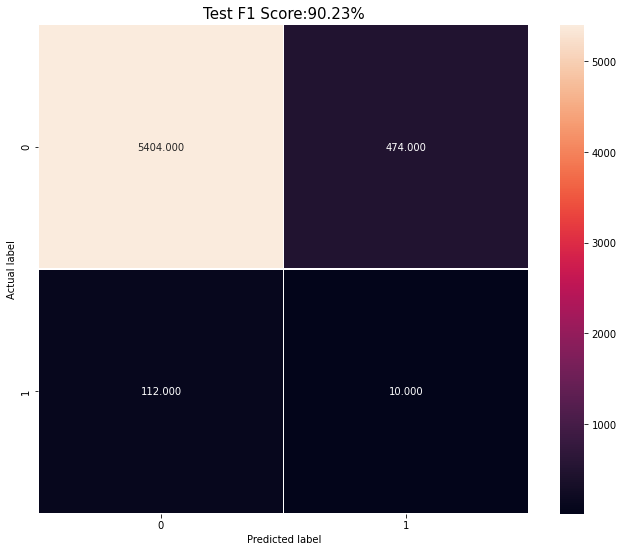

In [80]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

conf_matrix = confusion_matrix(y_test, test_pred)
print(conf_matrix)

plt.figure(figsize=(11,9))
sns.heatmap(conf_matrix, annot=True, fmt=".3f", linewidths=.5)

plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Test F1 Score:{}%'.format(round(score, 4)*100)
plt.title(all_sample_title, size = 15)

In [81]:
from sklearn.metrics import classification_report

print('*********************  Training Data Report  **********')
print(classification_report(y_train, train_pred))

print('***********************  Test Data Report  **********')
print(classification_report(y_test, test_pred))

*********************  Training Data Report  **********
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     13734
           1       1.00      1.00      1.00     13734

    accuracy                           1.00     27468
   macro avg       1.00      1.00      1.00     27468
weighted avg       1.00      1.00      1.00     27468

***********************  Test Data Report  **********
              precision    recall  f1-score   support

           0       0.98      0.92      0.95      5878
           1       0.02      0.08      0.03       122

    accuracy                           0.90      6000
   macro avg       0.50      0.50      0.49      6000
weighted avg       0.96      0.90      0.93      6000

